In [1]:
import pandas as pd
import polars as pl
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

sns.set_theme(style="whitegrid")
pd.set_option('display.max_columns', 100)
pd.set_option('display.float_format', lambda x: '%.3f' % x)

map_obito = {0: 'Sobrevivente', 1: 'Óbito'}

In [2]:
df_dengue = pl.read_parquet("./data/dengue.parquet")

In [3]:
df_dengue['TARGET_OBITO'].value_counts(sort=True)

TARGET_OBITO,count
i32,u32
0,9740330
1,12550


In [4]:
df_dengue.schema

Schema([('TARGET_OBITO', Int32),
        ('IDADE_ANOS', Int64),
        ('FAIXA_ETARIA', String),
        ('DIAS_SINTOMA_INVESTIGACAO', Int64),
        ('DIAS_ALARME_INVESTIGACAO', Int64),
        ('DIAS_GRAVE_INVESTIGACAO', Int64),
        ('CS_SEXO', Categorical),
        ('SG_UF', Int64),
        ('IS_GESTANTE', Int32),
        ('BIN_ALRM_HIPOT', Int32),
        ('BIN_ALRM_PLAQ', Int32),
        ('BIN_ALRM_VOM', Int32),
        ('BIN_ALRM_SANG', Int32),
        ('BIN_ALRM_HEMAT', Int32),
        ('BIN_ALRM_ABDOM', Int32),
        ('BIN_ALRM_LETAR', Int32),
        ('BIN_ALRM_HEPAT', Int32),
        ('BIN_ALRM_LIQ', Int32),
        ('BIN_GRAV_PULSO', Int32),
        ('BIN_GRAV_CONV', Int32),
        ('BIN_GRAV_ENCH', Int32),
        ('BIN_GRAV_INSUF', Int32),
        ('BIN_GRAV_TAQUI', Int32),
        ('BIN_GRAV_EXTRE', Int32),
        ('BIN_GRAV_HIPOT', Int32),
        ('BIN_GRAV_HEMAT', Int32),
        ('BIN_GRAV_MELEN', Int32),
        ('BIN_GRAV_METRO', Int32),
        ('BIN_GRAV

In [5]:
df_dengue = df_dengue.with_row_index("row_id")

In [6]:
ids_mortes = df_dengue.filter(pl.col("TARGET_OBITO") == 1).select("row_id")
ids_vivos = df_dengue.filter(pl.col("TARGET_OBITO") == 0).select("row_id")

In [7]:
val_ids_mortes = ids_mortes.sample(fraction=0.2, seed=42, with_replacement=False)
val_ids_vivos = ids_vivos.sample(fraction=0.2, seed=42, with_replacement=False)

val_ids = pl.concat([val_ids_mortes, val_ids_vivos])

df_validation = df_dengue.join(val_ids, on="row_id", how="inner")

In [8]:
df_validation.write_parquet("./data/dengue_val.parquet")
del df_validation

In [9]:
df_train = df_dengue.join(val_ids, on="row_id", how="anti")
del df_dengue

In [10]:
train_mortes = df_train.filter(pl.col("TARGET_OBITO") == 1)
train_vivos = df_train.filter(pl.col("TARGET_OBITO") == 0)

eda_mortes = train_mortes
n_faltante = 100_000 - eda_mortes.height
eda_vivos = train_vivos.sample(n=n_faltante, seed=42, with_replacement=False)
df_eda_polars = pl.concat([eda_mortes, eda_vivos]).sample(fraction=1.0, seed=42)
df_eda_pandas = df_eda_polars.drop("row_id").to_pandas()

In [11]:
print("\nContagem de classes no EDA:")
print(df_eda_pandas["TARGET_OBITO"].value_counts())


Contagem de classes no EDA:
TARGET_OBITO
0    89960
1    10040
Name: count, dtype: int64


In [12]:
TARGET_N = 200_000
counts = df_train["TARGET_OBITO"].value_counts()
total_train = df_train.height

n_vivos_train = counts.filter(pl.col("TARGET_OBITO") == 0)["count"][0]
n_mortos_train = counts.filter(pl.col("TARGET_OBITO") == 1)["count"][0]

req_vivos = int((n_vivos_train / total_train) * TARGET_N)
req_mortos = int((n_mortos_train / total_train) * TARGET_N)

diff = TARGET_N - (req_vivos + req_mortos)
if diff != 0:
    req_vivos += diff # Jogamos a diferença nos vivos (classe majoritária)

print(f"Meta de amostragem: {req_vivos} vivos e {req_mortos} óbitos.")

Meta de amostragem: 199743 vivos e 257 óbitos.


In [13]:
sample_vivos = df_train.filter(pl.col("TARGET_OBITO") == 0).sample(n=req_vivos, seed=42)
sample_mortos = df_train.filter(pl.col("TARGET_OBITO") == 1).sample(n=req_mortos, seed=42)

df_eda_rep_polars = pl.concat([sample_vivos, sample_mortos]).sample(fraction=1.0, seed=42)

df_eda_representativo = df_eda_rep_polars.drop("row_id").to_pandas()

print("-" * 30)
print("Verificação de Proporções:")
prop_orig = n_mortos_train / total_train
prop_sample = df_eda_representativo["TARGET_OBITO"].mean()

print(f"Proporção Original de Mortes: {prop_orig:.5%}")
print(f"Proporção na Amostra (200k):  {prop_sample:.5%}")
print("-" * 30)

del df_train

------------------------------
Verificação de Proporções:
Proporção Original de Mortes: 0.12868%
Proporção na Amostra (200k):  0.12850%
------------------------------


## Análise do EDA dos dados representativos (200K) de amostra

In [14]:
df_eda_representativo['STATUS'] = df_eda_representativo['TARGET_OBITO'].map(map_obito)

fig = px.histogram(df_eda_representativo, 
                   x="IDADE_ANOS", 
                   color="CS_SEXO", 
                   barmode="overlay",
                   title="Distribuição de Casos por Idade e Sexo (Amostra Representativa)",
                   opacity=0.75,
                   nbins=100)
fig.update_layout(xaxis_title="Idade", yaxis_title="Contagem de Casos")
fig.show()

In [15]:
uf_counts = df_eda_representativo['SG_UF'].value_counts().reset_index()
uf_counts.columns = ['UF', 'Casos']

fig = px.bar(uf_counts, x='UF', y='Casos', 
             title="Casos Notificados por UF (Amostra Representativa)",
             text_auto=True)
fig.update_xaxes(type='category') # Força eixo categórico pois UF é Int
fig.show()

In [16]:
cols_dias = ['DIAS_SINTOMA_INVESTIGACAO',
             'DIAS_ALARME_INVESTIGACAO',
             'DIAS_GRAVE_INVESTIGACAO']

df_long_dias = df_eda_representativo.melt(
    id_vars='TARGET_OBITO',          # mantém a info “morreu ou não”
    value_vars=cols_dias,
    var_name='Tipo_Dias',
    value_name='Dias'
)
fig = px.box(
    df_long_dias,
    x="Tipo_Dias",
    y="Dias",
    title="Distribuição de Tempos de Resposta/Investigação",
    points="outliers",          # ou "all" se quiser ver todos os pontos
    color="TARGET_OBITO"        # 0/1 ou 'Sim'/'Não'
)
fig.show()


/tmp/ipykernel_99550/130951313.py:10: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




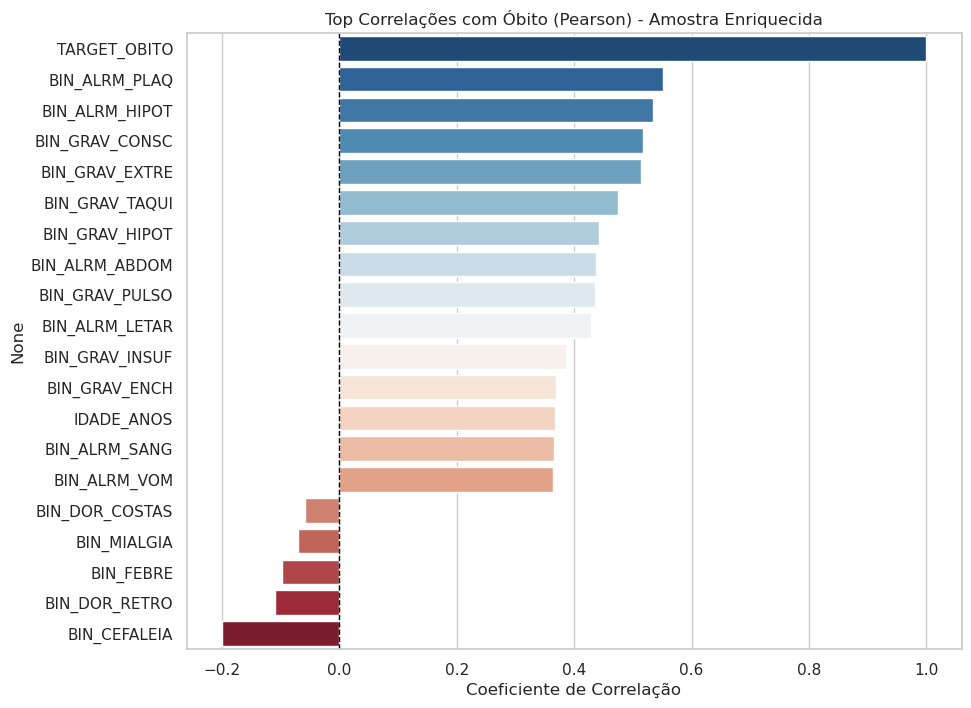

In [17]:
numeric_cols = df_eda_pandas.select_dtypes(include=[np.number]).columns

# Calcular correlação apenas contra o TARGET
corr_target = df_eda_pandas[numeric_cols].corrwith(df_eda_pandas['TARGET_OBITO']).sort_values(ascending=False)

# Pegar Top 15 positivas e Top 5 negativas (fatores de proteção?)
top_corr = pd.concat([corr_target.head(15), corr_target.tail(5)])

plt.figure(figsize=(10, 8))
sns.barplot(x=top_corr.values, y=top_corr.index, palette="RdBu_r")
plt.title('Top Correlações com Óbito (Pearson) - Amostra Enriquecida')
plt.xlabel('Coeficiente de Correlação')
plt.axvline(x=0, color='black', linestyle='--', linewidth=1)
plt.show()

In [18]:
bin_cols = [c for c in df_eda_pandas.columns if c.startswith('BIN_')]

# Agrupar por Target e tirar a média (que em binários = proporção/frequência)
sintomas_mean = df_eda_pandas.groupby('TARGET_OBITO')[bin_cols].mean().T
sintomas_mean.columns = ['Sobrevivente', 'Óbito']

# Calcular a diferença absoluta para filtrar os mais relevantes
sintomas_mean['Diff'] = abs(sintomas_mean['Óbito'] - sintomas_mean['Sobrevivente'])
sintomas_relevantes = sintomas_mean.sort_values('Diff', ascending=False).head(20)

# Plotar
fig = go.Figure()
fig.add_trace(go.Bar(y=sintomas_relevantes.index, x=sintomas_relevantes['Sobrevivente'], 
                     name='Sobreviventes', orientation='h', marker_color='blue'))
fig.add_trace(go.Bar(y=sintomas_relevantes.index, x=sintomas_relevantes['Óbito'], 
                     name='Óbitos', orientation='h', marker_color='red'))

fig.update_layout(barmode='group', 
                  title="Prevalência de Sintomas/Sinais: Sobreviventes vs Óbitos (Top 20 Diferenças)",
                  xaxis_title="Proporção (Média)",
                  height=800)
fig.show()

In [19]:
fig1 = px.box(df_eda_pandas, x="TARGET_OBITO", y="IDADE_ANOS", 
              color="TARGET_OBITO", 
              title="Impacto da Idade no Desfecho",
              color_discrete_map={0: 'blue', 1: 'red'})

# Dias de Sintoma até Investigação
fig2 = px.box(df_eda_pandas, x="TARGET_OBITO", y="DIAS_SINTOMA_INVESTIGACAO", 
              color="TARGET_OBITO", 
              title="Dias Sintoma -> Investigação vs Desfecho") # Cuidado com outliers aqui!

fig1.show()
fig2.show()